# Importing and loading 

In [25]:
import pandas as pd
from sklearn.preprocessing import StandardScaler, LabelEncoder
import numpy as np
import os
import json
from sklearn.ensemble import RandomForestRegressor
from skopt import BayesSearchCV
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
import numpy as np

In [4]:
rentals_df_final = pd.read_csv('downloads/SB-Case Study Materials/data/snp_dld_2024_rents.csv')

/var/folders/_v/g06y6s951r7f6p_2dfh591m40000gn/T/ipykernel_70891/673208426.py:1: DtypeWarning: Columns (35,36) have mixed types. Specify dtype option on import or set low_memory=False.
  rentals_df_final = pd.read_csv('downloads/SB-Case Study Materials/data/snp_dld_2024_rents.csv')


In [33]:
print("=== Rentals DataFrame ===")
print(rentals_df_final.head())
print("\nRentals DataFrame Info:")
print(rentals_df_final.info())
print("\nRentals DataFrame Description:")
print(rentals_df_final.describe())

=== Rentals DataFrame ===
   ejari_contract_number    registration_date contract_start_date  \
0        120130625001365  2024-01-24 11:14:33          2024-01-01   
1        120130626005726  2024-01-09 16:48:47          2024-03-18   
2        120130626007829  2024-01-16 11:39:26          2024-01-01   
3        120130627008661  2024-01-15 18:28:05          2024-01-01   
4        120130627009439  2024-01-22 13:34:29          2024-01-01   

  contract_end_date  version_number version_text  contract_amount  \
0        2024-12-31              12      Renewed          58000.0   
1        2025-03-17              12      Renewed          88000.0   
2        2024-12-31              12      Renewed          94000.0   
3        2024-12-31              12      Renewed          66000.0   
4        2024-12-31              12      Renewed          31200.0   

   annual_amount is_freehold is_freehold_text  ...       nearest_mall_en  \
0        58000.0           f    Non Free Hold  ...    City Centre Mi

In [34]:
# Compute the mean of the 'amount' column
mean_amount = rentals_df_final['annual_amount'].mean()

print(f"Mean of 'annual_amount' column: {mean_amount:.2f}")

Mean of 'annual_amount' column: 349716.81


# Pre-processing and EDA

/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



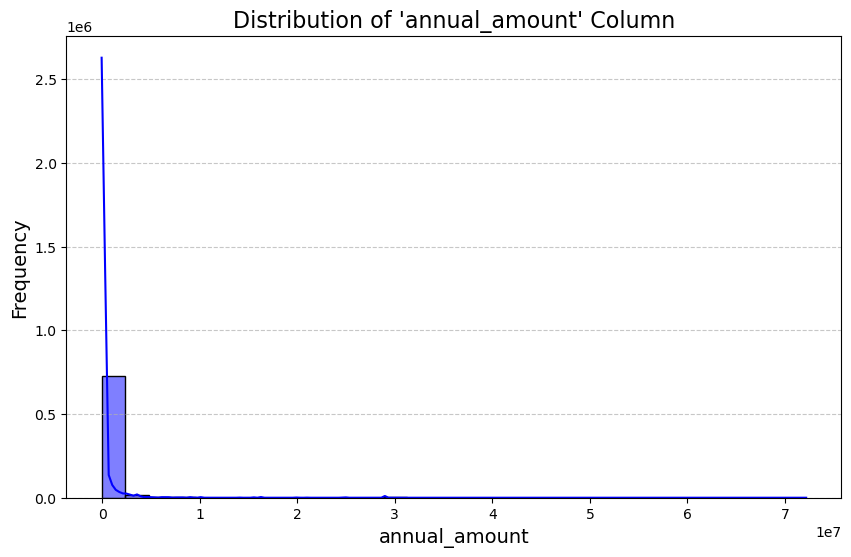

In [32]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the distribution of the 'amount' column
plt.figure(figsize=(10, 6))
sns.histplot(rentals_df_final['annual_amount'], kde=True, bins=30, color='blue')

# Add title and labels
plt.title("Distribution of 'annual_amount' Column", fontsize=16)
plt.xlabel("annual_amount", fontsize=14)
plt.ylabel("Frequency", fontsize=14)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Show the plot
plt.show()

In [36]:
import plotly.express as px

# Remove rows with 'annual_amount' > 2,500,000
#final_outliers_filtered_rentals_df = rentals_df_final[rentals_df_final['annual_amount'] <= 2500000]

# Create a histogram for the filtered 'annual_amount' column
fig = px.histogram(
    rentals_df_final, 
    x='annual_amount', 
    nbins=30,  # Number of bins in the histogram
    title="Distribution of Annual Amount ",
    labels={"annual_amount": "Annual Amount"},  # Axis label
    template="plotly_white"  # Aesthetic template
)

# Customize layout
fig.update_layout(
    xaxis=dict(title="Annual Amount"),
    yaxis=dict(title="Frequency"),
    title_font_size=18,
)

# Show the plot
fig.show()

### By hovering over the interactive plot above, we can see that annual amount values > 2,500,000 are outliers

In [7]:
import plotly.express as px

# Remove rows with 'annual_amount' > 2,500,000
final_outliers_filtered_rentals_df = rentals_df_final[rentals_df_final['annual_amount'] <= 2500000]

# Create a histogram for the filtered 'annual_amount' column
fig = px.histogram(
    final_outliers_filtered_rentals_df, 
    x='annual_amount', 
    nbins=30,  # Number of bins in the histogram
    title="Distribution of Annual Amount (Filtered <= 2,500,000)",
    labels={"annual_amount": "Annual Amount"},  # Axis label
    template="plotly_white"  # Aesthetic template
)

# Customize layout
fig.update_layout(
    xaxis=dict(title="Annual Amount"),
    yaxis=dict(title="Frequency"),
    title_font_size=18,
)

# Show the plot
fig.show()

## The spread of the target variable is much better after removing the outliers

In [123]:
# Calculate the 1st and 99th percentiles
lower_bound = rentals_df_2['annual_amount'].quantile(0.01)
upper_bound = rentals_df_2['annual_amount'].quantile(0.99)

print(f"1st Percentile (Lower Bound): {lower_bound}")
print(f"99th Percentile (Upper Bound): {upper_bound}")

# Identify outliers
outliers = rentals_df_2[(rentals_df_2['annual_amount'] < lower_bound) | (rentals_df_2['annual_amount'] > upper_bound)]

print(f"Number of Outliers: {outliers.shape[0]}")

# Display the outliers
print(outliers)

1st Percentile (Lower Bound): 14000.0
99th Percentile (Upper Bound): 5150000.0
Number of Outliers: 14595
        ejari_contract_number    registration_date contract_start_date  \
60            120130722000183  2024-01-30 10:57:25          2023-07-01   
136           120130822000499  2024-01-30 10:55:14          2024-01-01   
319           120131028001660  2024-01-25 11:30:47          2024-01-01   
488           120131222001620  2024-01-03 14:12:45          2024-01-01   
542           120140102000026  2024-01-10 09:44:41          2024-01-01   
...                       ...                  ...                 ...   
746681        220240924005447  2024-09-24 15:14:00          2024-10-09   
746682        220240924005447  2024-09-24 15:14:00          2024-10-09   
746683        220240924005447  2024-09-24 15:14:00          2024-10-09   
746684        220240924005447  2024-09-24 15:14:00          2024-10-09   
746825        220240924007603  2024-09-24 18:45:53          2024-10-01   

      

### After careful analysis of the outliers(1 and 99 percentile), target values less than 2,500,000 AED were removed

In [49]:
# Count rows with 'annual_amount' <= 2,500,000
final_filtered_count = final_outliers_filtered_rentals_df.shape[0]

print(f"Count of rows with 'annual_amount' <= 2,500,000: {final_filtered_count}")

Count of rows with 'annual_amount' <= 2,500,000: 727765


## Making a separate list for the low quality columns based on initial intuitive analysis of the dataset based on domain knowledge

In [16]:
low_quality_cols = ['contract_start_date','contract_end_date','building_age','ejari_contract_number','registration_date','version_number','version_text','contract_amount','is_freehold','parcel_id','property_id','land_property_id','property_type_ar','property_subtype_ar','property_usage_ar','property_usage_id','project_name_ar','area_ar','area_id','nearest_landmark_ar','nearest_metro_ar','nearest_mall_ar','master_project_en','rooms','parking','project_name_en','master_project_ar','req_from','req_to','entry_id','meta_ts','ejari_property_type_id','ejari_property_sub_type_id','transaction_datetime', 'transaction_subtype_id','transaction_number','transaction_type_id','property_usage_id','parcel_id','transaction_size_sqm','property_id','property_type_ar','property_type_id','property_subtype_ar','property_subtype_id','rooms_ar','project_name_ar','area_ar','area_id','nearest_landmark_ar','nearest_metro_ar','nearest_mall_ar','master_project_ar','req_from','req_to','entry_id','meta_ts'] #remove id columns, give logic, add to low quality list here


In [ ]:
rentals_df = rentals_df.drop(columns=[col for col in low_quality_cols if col in rentals_df.columns], errors='ignore')

In [18]:
final_outliers_filtered_rentals_df= final_outliers_filtered_rentals_df.drop(columns=[col for col in low_quality_cols if col in final_outliers_filtered_rentals_df.columns], errors='ignore')

In [13]:
date_cols =['contract_start_date','contract_end_date']

### Converting date columns to datetime and extracting new features 

In [14]:
for col in date_cols:
        if col in final_outliers_filtered_rentals_df.columns:

            final_outliers_filtered_rentals_df[col] = pd.to_datetime(final_outliers_filtered_rentals_df[col], errors='coerce') 
            final_outliers_filtered_rentals_df[f'{col}_year'] = final_outliers_filtered_rentals_df[col].dt.year
            final_outliers_filtered_rentals_df[f'{col}_month'] = final_outliers_filtered_rentals_df[col].dt.month
            final_outliers_filtered_rentals_df[f'{col}_day'] = final_outliers_filtered_rentals_df[col].dt.day

### Deriving a new feature contract length 

In [15]:
final_outliers_filtered_rentals_df['contract_length'] = ((final_outliers_filtered_rentals_df.contract_end_date - final_outliers_filtered_rentals_df.contract_start_date) / np.timedelta64(1, 'D')) / 30
final_outliers_filtered_rentals_df['contract_length'] = final_outliers_filtered_rentals_df['contract_length'].astype(int)

### Using SweetViz library for EDA 
#### Install sweetviz using pip

In [78]:
report2 = sv.analyze(transactions_df)
report2.show_html("Transactions_EDA_Report.html")

                                             |      | [  0%]   00:00 -> (? left)

Report Transactions_EDA_Report.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


## Using one-hot encoding for categorical features

In [19]:
# Perform one-hot encoding on all categorical columns
# Automatically identifies categorical columns
categorical_columns = final_outliers_filtered_rentals_df.select_dtypes(include=['object', 'category']).columns

# Apply one-hot encoding
rentals_encoded = pd.get_dummies(final_outliers_filtered_rentals_df, columns=categorical_columns, drop_first=True)

# Display the first few rows of the encoded DataFrame
print("One-hot encoded DataFrame:")
print(rentals_encoded.head())

# Save the one-hot encoded DataFrame to a CSV file (optional)
rentals_encoded.to_csv("rentals_encoded.csv", index=False)
print("One-hot encoded DataFrame saved to rentals_encoded.csv")


One-hot encoded DataFrame:
   annual_amount  property_size_sqm  total_properties  \
0        58000.0             120.76                 1   
1        88000.0             159.03                 1   
2        94000.0              60.94                 1   
3        66000.0             108.88                 1   
4        31200.0              57.60                 1   

   contract_start_date_year  contract_start_date_month  \
0                      2024                          1   
1                      2024                          3   
2                      2024                          1   
3                      2024                          1   
4                      2024                          1   

   contract_start_date_day  contract_end_date_year  contract_end_date_month  \
0                        1                    2024                       12   
1                       18                    2025                        3   
2                        1                  

In [47]:
rentals_encoded.columns

Index(['annual_amount', 'property_size_sqm', 'total_properties',
       'contract_start_date_year', 'contract_start_date_month',
       'contract_start_date_day', 'contract_end_date_year',
       'contract_end_date_month', 'contract_end_date_day', 'contract_length',
       ...
       'nearest_metro_en_Salah Al Din Metro Station',
       'nearest_metro_en_Sharaf Dg Metro Station',
       'nearest_metro_en_Terminal 3 ',
       'nearest_metro_en_Trade Centre Metro Station',
       'nearest_metro_en_UAE Exchange Metro Station',
       'nearest_metro_en_Union Metro Station', 'nearest_mall_en_Dubai Mall',
       'nearest_mall_en_Ibn-e-Battuta Mall',
       'nearest_mall_en_Mall of the Emirates', 'nearest_mall_en_Marina Mall'],
      dtype='object', length=356)

## Performing correlation analysis with a threshold of 0.85
### This will remove the highly correlated features and improve the feature selection process

In [39]:
def correlation_analysis(df, threshold=0.85):
    """
    Perform correlation analysis to drop highly correlated features.
    """
    print("Running correlation analysis...")
    corr_matrix = df.corr().abs()
    upper_triangle = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
    to_drop = [column for column in upper_triangle.columns if any(upper_triangle[column] > threshold)]
    df = df.drop(columns=to_drop, errors='ignore')
    print(to_drop)
    print(f"Dropped {len(to_drop)} correlated features.")
    return df, to_drop

In [37]:
# Drop rows where 'annual_amount' is NaN
rentals_encoded = rentals_encoded.dropna(subset=['annual_amount'])

# Confirm the operation
print(f"Number of rows after dropping NaNs: {rentals_encoded.shape[0]}")

Number of rows after dropping NaNs: 727765


In [50]:
rentals_encoded.shape

(727765, 356)

## Training the model

In [51]:
X = rentals_encoded.drop(columns=["annual_amount"])
y = rentals_encoded["annual_amount"]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [52]:
# Assuming y is a Pandas Series or NumPy array
if isinstance(y, pd.Series):
    nan_count = y.isna().sum()  # For Pandas Series
elif isinstance(y, np.ndarray):
    nan_count = np.isnan(y).sum()  # For NumPy array
else:
    raise TypeError("y must be a Pandas Series or NumPy array")

print(f"Number of NaN values in y: {nan_count}")

Number of NaN values in y: 0


In [27]:
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(582212, 355) (145553, 355) (582212,) (145553,)


### Training XGBoost Model 
#### Reasoning for XGBoost in Rentals Dataset: XGBoost is ideal for the rentals dataset as it handles sparse, high-dimensional data effectively, ensuring robust performance and feature importance insights.

#### Reasoning for the Problem as a Whole: XGBoost’s ability to manage non-linear relationships and its scalability makes it suitable for solving predictive tasks in real estate, balancing accuracy and computational efficiency(due to resource constraints)

In [ ]:
import xgboost as xgb
# Define the parameter grid for XGBoost
param_grid = {
    "n_estimators": [300, 400, 500],         # Number of trees
    "max_depth": [10,20,50],                # Maximum depth of trees
    "learning_rate": [0.05, 0.1, 0.15],    # Learning rate (eta)
}

# Initialize the XGBoost Regressor
xgb_model = xgb.XGBRegressor(objective="reg:squarederror", random_state=42)

# Initialize GridSearchCV
grid_search = GridSearchCV(
    estimator=xgb_model,
    param_grid=param_grid,
    cv=3,                               # 3-fold cross-validation
    scoring="neg_mean_squared_error",   # Use negative MSE for scoring
    n_jobs=-1,                          # Use all CPU cores
    verbose=1                           # Display progress
)

# Train the model with GridSearchCV
print("Training XGBoost with GridSearchCV...")
grid_search.fit(X_train, y_train)

# Best parameters and evaluation
print("Best Parameters:")
print(grid_search.best_params_)

best_model = grid_search.best_estimator_

# Predict and evaluate
y_pred = best_model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

print(f"Evaluation Metrics:")
print(f"RMSE: {rmse:.2f}")
print(f"R²: {r2:.2f}")
print(f"MAE: {mae:.2f}")

# Create a DataFrame for actual vs predicted
comparison_df = pd.DataFrame({
    "Actual": y_test,
    "Predicted": y_pred
}).reset_index(drop=True)

print(comparison_df.head())

# Save the results to a CSV file (optional)
comparison_df.to_csv("xgboost_predictions_vs_actuals.csv", index=False)
print("Comparison saved to xgboost_predictions_vs_actuals.csv")

In [108]:
import xgboost as xgb
# Define the parameter grid for XGBoost
param_grid = {
    "n_estimators": [100, 200],         # Number of trees
    "max_depth": [5, 10, 12],                # Maximum depth of trees
    "learning_rate": [0.01, 0.05, 0.1],    # Learning rate (eta)
}

# Initialize the XGBoost Regressor
xgb_model = xgb.XGBRegressor(objective="reg:squarederror", random_state=42)

# Initialize GridSearchCV
grid_search = GridSearchCV(
    estimator=xgb_model,
    param_grid=param_grid,
    cv=3,                               # 3-fold cross-validation
    scoring="neg_mean_squared_error",   # Use negative MSE for scoring
    n_jobs=-1,                          # Use all CPU cores
    verbose=1                           # Display progress
)

# Train the model with GridSearchCV
print("Training XGBoost with GridSearchCV...")
grid_search.fit(X_train, y_train)

# Best parameters and evaluation
print("Best Parameters:")
print(grid_search.best_params_)

best_model = grid_search.best_estimator_

# Predict and evaluate
y_pred = best_model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

print(f"Evaluation Metrics:")
print(f"RMSE: {rmse:.2f}")
print(f"R²: {r2:.2f}")
print(f"MAE: {mae:.2f}")

# Create a DataFrame for actual vs predicted
comparison_df = pd.DataFrame({
    "Actual": y_test,
    "Predicted": y_pred
}).reset_index(drop=True)

print(comparison_df.head())

# Save the results to a CSV file (optional)
comparison_df.to_csv("xgboost_predictions_vs_actuals.csv", index=False)
print("Comparison saved to xgboost_predictions_vs_actuals.csv")

Training XGBoost with GridSearchCV...
Fitting 3 folds for each of 18 candidates, totalling 54 fits


/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arr

Best Parameters:
{'learning_rate': 0.1, 'max_depth': 10, 'n_estimators': 100}
Evaluation Metrics:
RMSE: 256184.98
R²: 0.98
MAE: 37438.94
    Actual      Predicted
0  15000.0   18685.037109
1  50000.0   46059.613281
2  55000.0   45430.070312
3  93000.0  103068.414062
4  90000.0   76214.882812
Comparison saved to xgboost_predictions_vs_actuals.csv


In [109]:
import xgboost as xgb
# Define the parameter grid for XGBoost
param_grid = {
    "n_estimators": [100, 200, 300],         # Number of trees
    "max_depth": [8, 10, 12],                # Maximum depth of trees
    "learning_rate": [0.01, 0.03, 0.05],    # Learning rate (eta)
}

# Initialize the XGBoost Regressor
xgb_model = xgb.XGBRegressor(objective="reg:squarederror", random_state=42)

# Initialize GridSearchCV
grid_search = GridSearchCV(
    estimator=xgb_model,
    param_grid=param_grid,
    cv=5,                               # 3-fold cross-validation
    scoring="neg_mean_squared_error",   # Use negative MSE for scoring
    n_jobs=-1,                          # Use all CPU cores
    verbose=1                           # Display progress
)

# Train the model with GridSearchCV
print("Training XGBoost with GridSearchCV...")
grid_search.fit(X_train, y_train)

# Best parameters and evaluation
print("Best Parameters:")
print(grid_search.best_params_)

best_model = grid_search.best_estimator_

# Predict and evaluate
y_pred = best_model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

print(f"Evaluation Metrics:")
print(f"RMSE: {rmse:.2f}")
print(f"R²: {r2:.2f}")
print(f"MAE: {mae:.2f}")

# Create a DataFrame for actual vs predicted
comparison_df = pd.DataFrame({
    "Actual": y_test,
    "Predicted": y_pred
}).reset_index(drop=True)

print(comparison_df.head())

# Save the results to a CSV file (optional)
comparison_df.to_csv("xgboost_predictions_vs_actuals.csv", index=False)
print("Comparison saved to xgboost_predictions_vs_actuals.csv")

Training XGBoost with GridSearchCV...
Fitting 5 folds for each of 18 candidates, totalling 90 fits


/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arr

Best Parameters:
{'learning_rate': 0.05, 'max_depth': 10, 'n_estimators': 200}
Evaluation Metrics:
RMSE: 252737.29
R²: 0.98
MAE: 37037.99
    Actual      Predicted
0  15000.0   18793.019531
1  50000.0   46088.332031
2  55000.0   46823.050781
3  93000.0  105986.710938
4  90000.0   74115.085938
Comparison saved to xgboost_predictions_vs_actuals.csv


In [112]:
import xgboost as xgb
# Define the parameter grid for XGBoost
param_grid = {
    "n_estimators": [100, 150, 200],         # Number of trees
    "max_depth": [5, 9, 10],                # Maximum depth of trees
    "learning_rate": [0.05, 0.08, 0.1, 0.15],    # Learning rate (eta)
}

# Initialize the XGBoost Regressor
xgb_model = xgb.XGBRegressor(objective="reg:squarederror", random_state=42)

# Initialize GridSearchCV
grid_search = GridSearchCV(
    estimator=xgb_model,
    param_grid=param_grid,
    cv=5,                               # 3-fold cross-validation
    scoring="neg_mean_squared_error",   # Use negative MSE for scoring
    n_jobs=-1,                          # Use all CPU cores
    verbose=1                           # Display progress
)

# Train the model with GridSearchCV
print("Training XGBoost with GridSearchCV...")
grid_search.fit(X_train, y_train)

# Best parameters and evaluation
print("Best Parameters:")
print(grid_search.best_params_)

best_model = grid_search.best_estimator_

# Predict and evaluate
y_pred = best_model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

print(f"Evaluation Metrics:")
print(f"RMSE: {rmse:.2f}")
print(f"R²: {r2:.2f}")
print(f"MAE: {mae:.2f}")

# Create a DataFrame for actual vs predicted
comparison_df = pd.DataFrame({
    "Actual": y_test,
    "Predicted": y_pred
}).reset_index(drop=True)

print(comparison_df.head())

# Save the results to a CSV file (optional)
comparison_df.to_csv("xgboost_predictions_vs_actuals.csv", index=False)
print("Comparison saved to xgboost_predictions_vs_actuals.csv")

Training XGBoost with GridSearchCV...
Fitting 5 folds for each of 36 candidates, totalling 180 fits
Best Parameters:
{'learning_rate': 0.1, 'max_depth': 9, 'n_estimators': 200}
Evaluation Metrics:
RMSE: 252905.47
R²: 0.98
MAE: 36260.68
    Actual     Predicted
0  15000.0  18254.751953
1  50000.0  44514.921875
2  55000.0  45529.281250
3  93000.0  96404.226562
4  90000.0  81334.921875
Comparison saved to xgboost_predictions_vs_actuals.csv


In [116]:
import xgboost as xgb
# Define the parameter grid for XGBoost
param_grid = {
    "n_estimators": [200, 250, 300, 500],         # Number of trees
    "max_depth": [8, 9, 10],                # Maximum depth of trees
    "learning_rate": [0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1],    # Learning rate (eta)
}

# Initialize the XGBoost Regressor
xgb_model = xgb.XGBRegressor(objective="reg:squarederror", random_state=42)

# Initialize GridSearchCV
grid_search = GridSearchCV(
    estimator=xgb_model,
    param_grid=param_grid,
    cv=5,                               # 3-fold cross-validation
    scoring="neg_mean_squared_error",   # Use negative MSE for scoring
    n_jobs=-1,                          # Use all CPU cores
    verbose=1                           # Display progress
)

# Train the model with GridSearchCV
print("Training XGBoost with GridSearchCV...")
grid_search.fit(X_train, y_train)

# Best parameters and evaluation
print("Best Parameters:")
print(grid_search.best_params_)

best_model = grid_search.best_estimator_

# Predict and evaluate
y_pred = best_model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

print(f"Evaluation Metrics:")
print(f"RMSE: {rmse:.2f}")
print(f"R²: {r2:.2f}")
print(f"MAE: {mae:.2f}")

# Create a DataFrame for actual vs predicted
comparison_df = pd.DataFrame({
    "Actual": y_test,
    "Predicted": y_pred
}).reset_index(drop=True)

print(comparison_df.head())

# Save the results to a CSV file (optional)
comparison_df.to_csv("xgboost_predictions_vs_actuals.csv", index=False)
print("Comparison saved to xgboost_predictions_vs_actuals.csv")

Training XGBoost with GridSearchCV...
Fitting 5 folds for each of 84 candidates, totalling 420 fits


/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arr

Best Parameters:
{'learning_rate': 0.07, 'max_depth': 8, 'n_estimators': 500}
Evaluation Metrics:
RMSE: 256733.65
R²: 0.98
MAE: 35967.31
    Actual      Predicted
0  15000.0   18479.041016
1  50000.0   43742.542969
2  55000.0   46605.929688
3  93000.0  100509.250000
4  90000.0   83671.976562
Comparison saved to xgboost_predictions_vs_actuals.csv


In [115]:
# Define the parameter grid for XGBoost
param_grid = {
    "n_estimators": [200, 250, 300],         # Number of trees
    "max_depth": [8, 9, 10],                # Maximum depth of trees
    "learning_rate": [0.06, 0.07, 0.08, 0.09, 0.1],    # Learning rate (eta)
}

# Initialize the XGBoost Regressor
xgb_model = xgb.XGBRegressor(objective="reg:squarederror", random_state=42)

# Initialize GridSearchCV
grid_search = GridSearchCV(
    estimator=xgb_model,
    param_grid=param_grid,
    cv=5,                               # 3-fold cross-validation
    scoring="neg_mean_squared_error",   # Use negative MSE for scoring
    n_jobs=-1,                          # Use all CPU cores
    verbose=1                           # Display progress
)

# Train the model with GridSearchCV
print("Training XGBoost with GridSearchCV...")
grid_search.fit(X_train, y_train)

# Best parameters and evaluation
print("Best Parameters:")
print(grid_search.best_params_)

best_model = grid_search.best_estimator_

# Predict and evaluate
y_pred = best_model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

print(f"Evaluation Metrics:")
print(f"RMSE: {rmse:.2f}")
print(f"R²: {r2:.2f}")
print(f"MAE: {mae:.2f}")

# Create a DataFrame for actual vs predicted
comparison_df = pd.DataFrame({
    "Actual": y_test,
    "Predicted": y_pred
}).reset_index(drop=True)

print(comparison_df.head())

# Save the results to a CSV file (optional)
comparison_df.to_csv("xgboost_predictions_vs_actuals_rentals.csv", index=False)
print("Comparison saved to xgboost_predictions_vs_actuals_rentals.csv")

Training XGBoost with GridSearchCV...
Fitting 5 folds for each of 45 candidates, totalling 225 fits
Best Parameters:
{'learning_rate': 0.09, 'max_depth': 8, 'n_estimators': 300}
Evaluation Metrics:
RMSE: 255997.78
R²: 0.98
MAE: 37700.09
    Actual     Predicted
0  15000.0  16962.380859
1  50000.0  44929.960938
2  55000.0  46571.968750
3  93000.0  99885.820312
4  90000.0  89583.960938
Comparison saved to xgboost_predictions_vs_actuals_rentals.csv


In [157]:
outliers_filtered_rentals_df = outliers_filtered_rentals_df.drop(columns=[col for col in low_quality_cols if col in outliers_filtered_rentals_df.columns], errors='ignore')

In [148]:
for col in date_cols:
        if col in outliers_filtered_rentals_df.columns:

            outliers_filtered_rentals_df[col] = pd.to_datetime(outliers_filtered_rentals_df[col], errors='coerce') 
            outliers_filtered_rentals_df[f'{col}_year'] = outliers_filtered_rentals_df[col].dt.year
            outliers_filtered_rentals_df[f'{col}_month'] = outliers_filtered_rentals_df[col].dt.month
            outliers_filtered_rentals_df[f'{col}_day'] = outliers_filtered_rentals_df[col].dt.day

/var/folders/_v/g06y6s951r7f6p_2dfh591m40000gn/T/ipykernel_29071/2687396406.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/_v/g06y6s951r7f6p_2dfh591m40000gn/T/ipykernel_29071/2687396406.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/_v/g06y6s951r7f6p_2dfh591m40000gn/T/ipykernel_29071/2687396406.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

In [149]:
outliers_filtered_rentals_df['contract_length'] = ((outliers_filtered_rentals_df.contract_end_date - outliers_filtered_rentals_df.contract_start_date) / np.timedelta64(1, 'D')) / 30
outliers_filtered_rentals_df['contract_length'] = outliers_filtered_rentals_df['contract_length'].astype(int)

/var/folders/_v/g06y6s951r7f6p_2dfh591m40000gn/T/ipykernel_29071/3217420717.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/_v/g06y6s951r7f6p_2dfh591m40000gn/T/ipykernel_29071/3217420717.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [158]:
correlation_analysis(outliers_filtered_rentals_df, threshold=0.85)

Running correlation analysis...
[]
Dropped 0 correlated features.


(        annual_amount  is_freehold_text  property_size_sqm  property_type_en  \
 0             58000.0                 1             120.76                 2   
 1             88000.0                 0             159.03                 2   
 2             94000.0                 1              60.94                 2   
 3             66000.0                 1             108.88                 2   
 4             31200.0                 1              57.60                 2   
 ...               ...               ...                ...               ...   
 747403        58000.0                 1              96.45                 2   
 747404        66150.0                 1             148.00                 2   
 747405        60000.0                 1              23.57                 2   
 747406       104363.0                 1             139.17                 2   
 747407        37000.0                 1              65.03                 2   
 
         property_subtype_

In [159]:
X = outliers_filtered_rentals_df.drop(columns=["annual_amount"])
y = outliers_filtered_rentals_df["annual_amount"]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [162]:
X_train.columns

Index(['is_freehold_text', 'property_size_sqm', 'property_type_en',
       'property_subtype_en', 'property_usage_en', 'total_properties',
       'area_en', 'nearest_landmark_en', 'nearest_metro_en', 'nearest_mall_en',
       'contract_start_date_year', 'contract_start_date_month',
       'contract_start_date_day', 'contract_end_date_year',
       'contract_end_date_month', 'contract_end_date_day', 'contract_length'],
      dtype='object')

In [161]:
import xgboost as xgb
# Define the parameter grid for XGBoost
param_grid = {
    "n_estimators": [200, 250, 300, 350, 400, 450, 500],         # Number of trees
    "max_depth": [8, 9, 10, 11, 12],                # Maximum depth of trees
    "learning_rate": [0.06, 0.08, 0.1, 0.12, 0.14],    # Learning rate (eta)
}

# Initialize the XGBoost Regressor
xgb_model = xgb.XGBRegressor(objective="reg:squarederror", random_state=42)

# Initialize GridSearchCV
grid_search = GridSearchCV(
    estimator=xgb_model,
    param_grid=param_grid,
    cv=3,                               # 3-fold cross-validation
    scoring="neg_mean_squared_error",   # Use negative MSE for scoring
    n_jobs=-1,                          # Use all CPU cores
    verbose=1                           # Display progress
)

# Train the model with GridSearchCV
print("Training XGBoost with GridSearchCV...")
grid_search.fit(X_train, y_train)

# Best parameters and evaluation
print("Best Parameters:")
print(grid_search.best_params_)

best_model = grid_search.best_estimator_

# Predict and evaluate
y_pred = best_model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

print(f"Evaluation Metrics:")
print(f"RMSE: {rmse:.2f}")
print(f"R²: {r2:.2f}")
print(f"MAE: {mae:.2f}")

# Create a DataFrame for actual vs predicted
comparison_df = pd.DataFrame({
    "Actual": y_test,
    "Predicted": y_pred
}).reset_index(drop=True)

print(comparison_df.head())

# Save the results to a CSV file (optional)
comparison_df.to_csv("xgboost_predictions_vs_actuals.csv", index=False)
print("Comparison saved to xgboost_predictions_vs_actuals.csv")

Training XGBoost with GridSearchCV...
Fitting 3 folds for each of 175 candidates, totalling 525 fits


/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning:

A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.

/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


Best Parameters:
{'learning_rate': 0.1, 'max_depth': 11, 'n_estimators': 500}
Evaluation Metrics:
RMSE: 63081.95
R²: 0.96
MAE: 19804.76
     Actual      Predicted
0  115000.0  107587.976562
1   93000.0   74032.054688
2   41000.0   38377.000000
3  120000.0  113207.453125
4   99000.0   96447.382812
Comparison saved to xgboost_predictions_vs_actuals.csv


### After optimizing XGBoost with Grid Search Cross Validation, the best Mean Squared Error (MSE) achieved was 19804. Considering the mean value of our target variable, annual_amount, is approximately 350,000 AED, this translates to an average prediction error of about 5%, which indicates the model's reasonable accuracy for this problem.

                              Feature  Importance
0                   property_size_sqm     48707.0
1                    total_properties     13872.0
2            contract_start_date_year      3717.0
3           contract_start_date_month     16543.0
4             contract_start_date_day     12646.0
5              contract_end_date_year      4831.0
6             contract_end_date_month      7523.0
7               contract_end_date_day      9441.0
8                     contract_length      5210.0
9      is_freehold_text_Non Free Hold      1063.0
10              property_type_en_Land       224.0
11              property_type_en_Unit      1246.0
12             property_type_en_Villa       134.0
13      property_type_en_Virtual Unit       186.0
14  property_subtype_en_Arabian House        30.0
15           property_subtype_en_Bank        55.0
16       property_subtype_en_Building        85.0
17         property_subtype_en_Cinema         6.0
18         property_subtype_en_Clinic       156.0


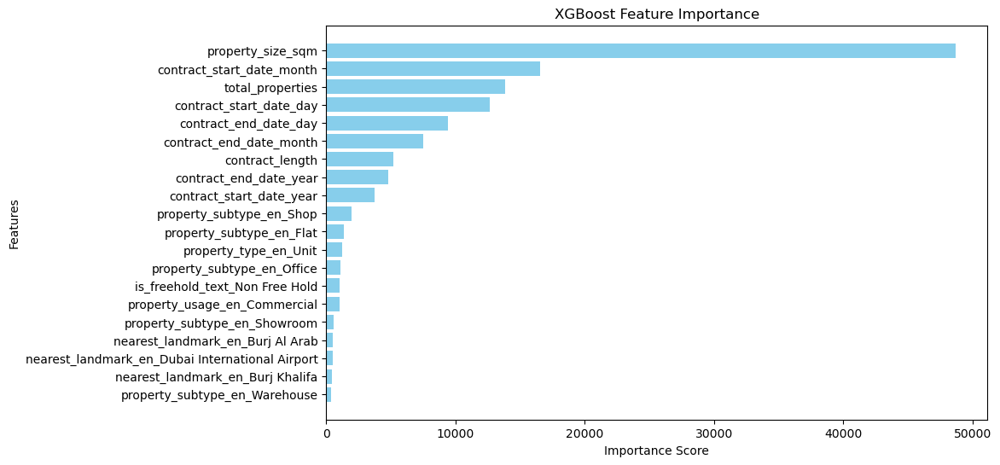

In [29]:
import matplotlib.pyplot as plt

# Assuming `xgb_model` is your trained XGBoost model
# and `X_train` contains the feature names

# Get feature importance from the model
feature_importance = best_model.get_booster().get_score(importance_type='weight')

# Convert feature importance to a DataFrame
importance_df = pd.DataFrame({
    'Feature': feature_importance.keys(),
    'Importance': feature_importance.values()
})

# Sort features by importance
top_20_importance_df = importance_df.sort_values(by='Importance', ascending=False).head(20)

# Display the feature importance DataFrame
print(importance_df.head(20))

# Plot feature importance
plt.figure(figsize=(10, 6))
plt.barh(top_20_importance_df['Feature'], top_20_importance_df['Importance'], color='skyblue')
plt.xlabel("Importance Score")
plt.ylabel("Features")
plt.title("XGBoost Feature Importance")
plt.gca().invert_yaxis()  # Invert y-axis to show most important features at the top
plt.show()


### This feature importance chart from XGBoost reveals that property_size_sqm is the most critical predictor of rental prices, significantly outweighing other variables. Temporal factors like contract_start_date_month and contract_end_date_day also play essential roles, likely indicating seasonal or temporal rental trends. Interestingly, total_properties suggests that the overall inventory influences rental pricing strategies. Future work could include more historical data spread over years, this would assist us in identifying cyclical/seasonal patterns.

In [28]:
import xgboost as xgb
# Define the parameter grid for XGBoost
param_grid = {
    "n_estimators": [500],         # Number of trees
    "max_depth": [11],                # Maximum depth of trees
    "learning_rate": [0.1],    # Learning rate (eta)
}

# Initialize the XGBoost Regressor
xgb_model = xgb.XGBRegressor(objective="reg:squarederror", random_state=42)

# Initialize GridSearchCV
grid_search = GridSearchCV(
    estimator=xgb_model,
    param_grid=param_grid,
    cv=3,                               # 3-fold cross-validation
    scoring="neg_mean_squared_error",   # Use negative MSE for scoring
    n_jobs=-1,                          # Use all CPU cores
    verbose=1                           # Display progress
)

# Train the model with GridSearchCV
print("Training XGBoost with GridSearchCV...")
grid_search.fit(X_train, y_train)

# Best parameters and evaluation
print("Best Parameters:")
print(grid_search.best_params_)

best_model = grid_search.best_estimator_

# Predict and evaluate
y_pred = best_model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

print(f"Evaluation Metrics:")
print(f"RMSE: {rmse:.2f}")
print(f"R²: {r2:.2f}")
print(f"MAE: {mae:.2f}")

# Create a DataFrame for actual vs predicted
comparison_df = pd.DataFrame({
    "Actual": y_test,
    "Predicted": y_pred
}).reset_index(drop=True)

print(comparison_df.head())

# Save the results to a CSV file (optional)
comparison_df.to_csv("xgboost_predictions_vs_actuals.csv", index=False)
print("Comparison saved to xgboost_predictions_vs_actuals.csv")

Training XGBoost with GridSearchCV...
Fitting 3 folds for each of 1 candidates, totalling 3 fits


/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
/Users/jaideepballani/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


Best Parameters:
{'learning_rate': 0.1, 'max_depth': 11, 'n_estimators': 500}
Evaluation Metrics:
RMSE: 66061.68
R²: 0.95
MAE: 22968.37
     Actual      Predicted
0  115000.0   96360.828125
1   93000.0   75797.468750
2   41000.0   46078.601562
3  120000.0  107179.609375
4   99000.0  116844.796875
Comparison saved to xgboost_predictions_vs_actuals.csv


### Best XGBoost Model performed well with ~6% error rate

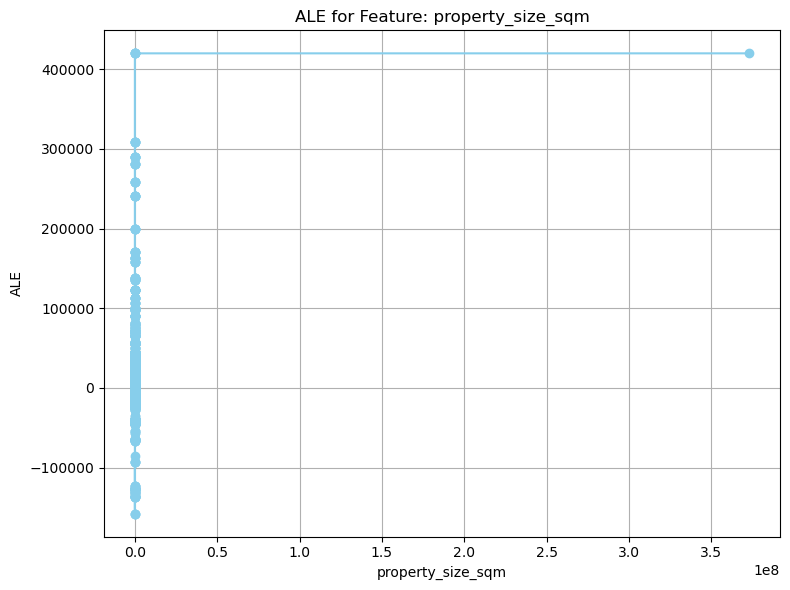

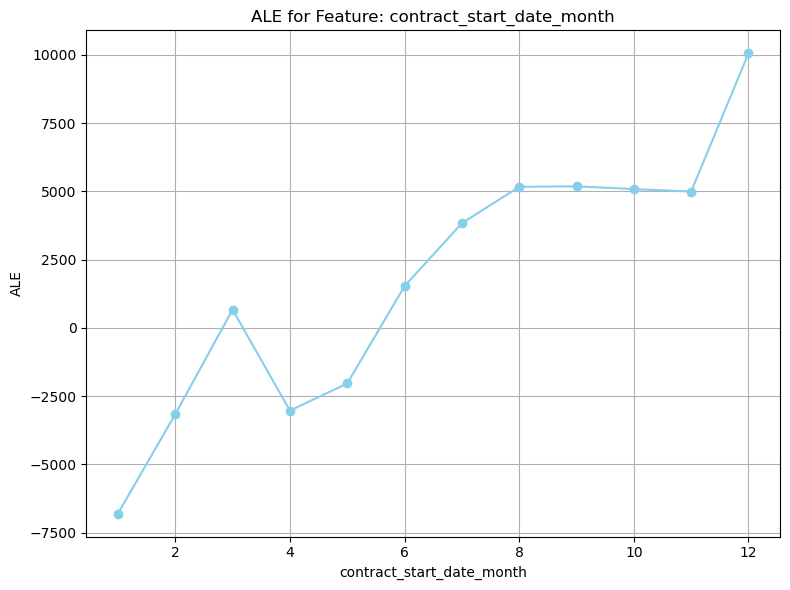

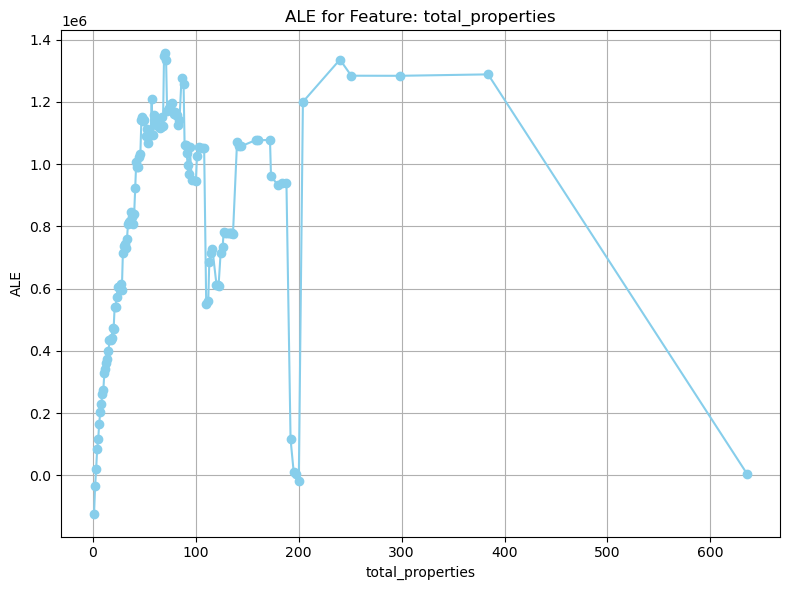

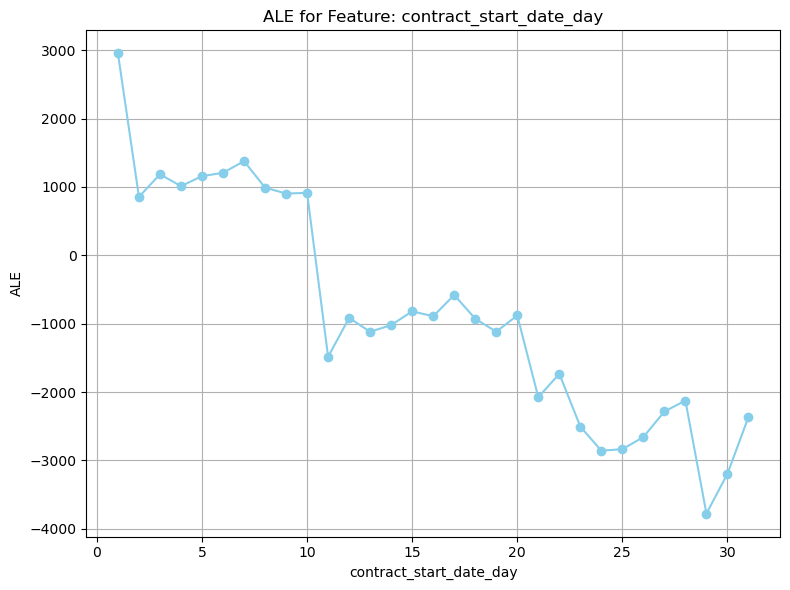

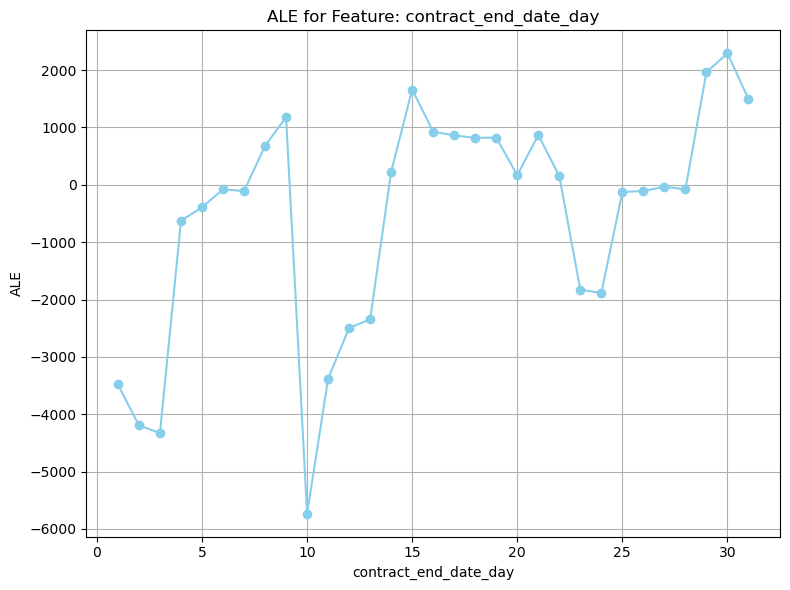

...

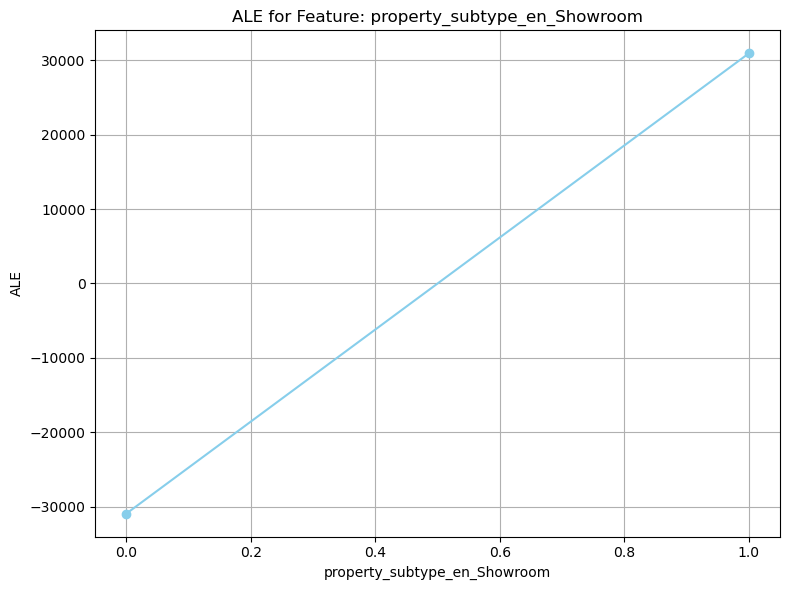

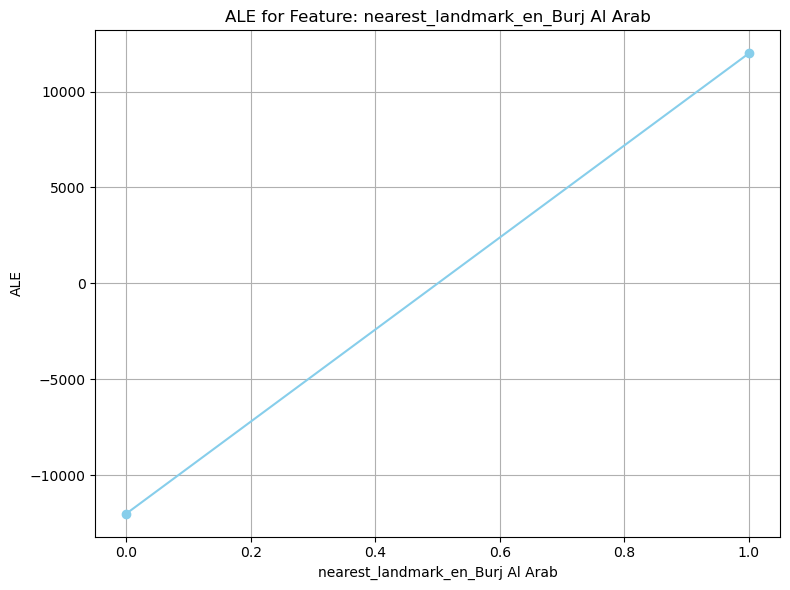

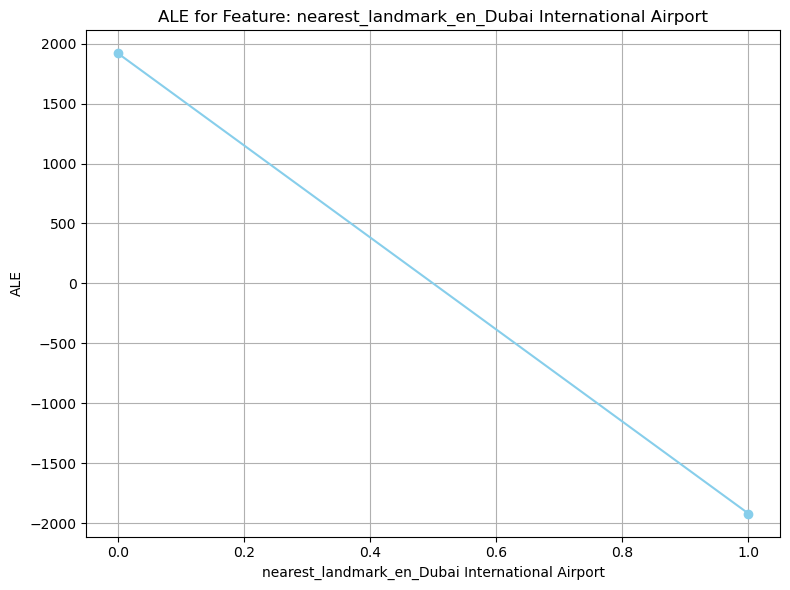

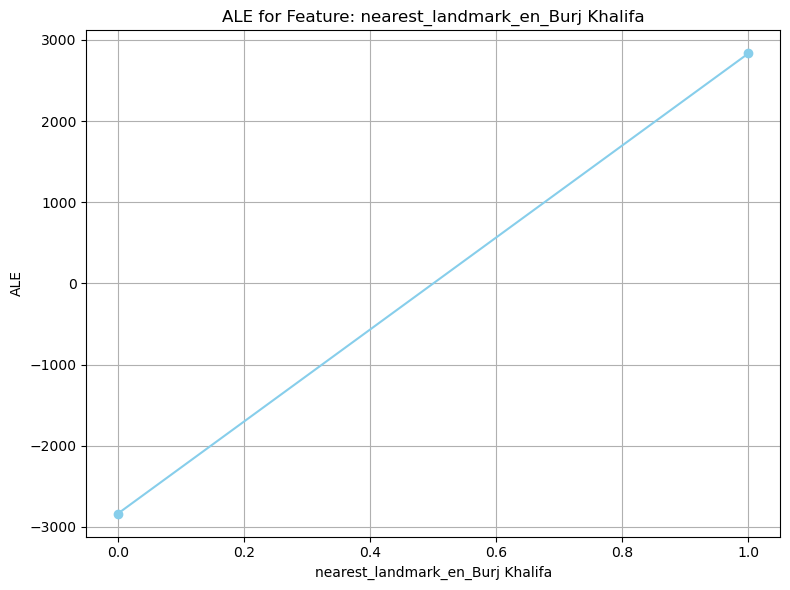

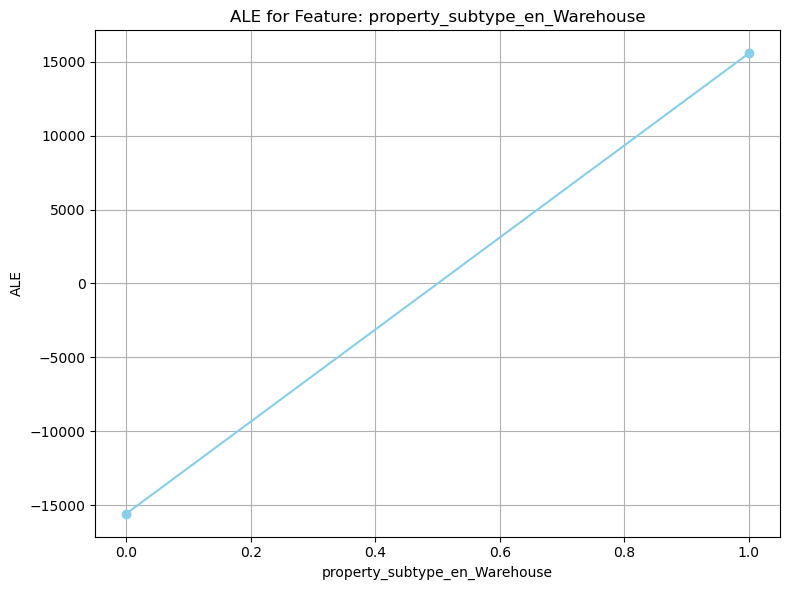

In [30]:
from alibi.explainers import ALE

def compute_and_plot_ale(model, X, feature_names, top_features_df):

    # Filter to top 20 features by importance
    top_features = top_features_df['Feature'].tolist()

    # Define a prediction function
    def predict_fn(X):
        return model.predict(X)

    # Initialize ALE explainer
    ale_explainer = ALE(predict_fn, feature_names=feature_names)

    # Compute ALE explanations
    ale_exp = ale_explainer.explain(X.values)

    # Plot ALE for the top 20 features
    for feature_name in top_features:
        feature_index = feature_names.index(feature_name)
        
        # Get ALE values and feature values for the selected feature
        ale_feature = ale_exp.ale_values[feature_index]
        ale_feature_centers = ale_exp.feature_values[feature_index]
        
        # Plot the ALE graph
        plt.figure(figsize=(8, 6))
        plt.plot(ale_feature_centers, ale_feature, marker='o', linestyle='-', color='skyblue')
        plt.xlabel(feature_name)
        plt.ylabel('ALE')
        plt.title(f'ALE for Feature: {feature_name}')
        plt.grid(True)
        plt.tight_layout()
        plt.show()

# Example Usage:
# Assume `best_model` is your trained model and `X_train` is your training dataset
# top_20_importance_df contains the column 'Feature' for feature names
compute_and_plot_ale(best_model, X_train, X_train.columns.tolist(), top_20_importance_df)


### Explaining one feature: The ALE plot for contract_start_date_month indicates strong seasonality in rental pricing. Rentals starting at the beginning of the year (e.g., January) are associated with lower prices, while contracts starting later in the year (e.g., November-December) are linked to significantly higher prices. This suggests demand surges during the year's end, potentially due to business cycles or peak moving periods.

## Challenges Faced: 
### Time Constraints due to complexity of the task
### Memory Constraints due to local memory limits
### Lack of features that were both informative and less correlated


## Future Work: 
### Analyse more ALE Graphs
### Augment dataset with more data - eg: historical data for time series/trends,  geo location data for better visualisation
### Consider using Cloud Instances for better performance

